In [1]:
import sys; sys.path.append('../../')
from DataPreparation.DataPreparation import read_data
import sys; sys.path.append('../../')
from DataPreparation.DataPreparation import read_data, convey_insights
from ModelPipelines.ModelAnalysis import recursive_feature_elimination, test_log_linearity,log_weights_analysis, show_hyperparams, vc_dimension_check,validation_curves,learning_curves, BiasVariance,svm_score
from sklearn import svm
from sklearn.metrics import classification_report
from HandleClassImbalance.HandleClassImbalance import *
from ModelPipelines.ModelVisualization import VisualizeModel
from sklearn.model_selection import RandomizedSearchCV
from IPython.display import clear_output, HTML
from scipy.stats import loguniform
from utils import nice_table, save_hyperparameters, load_hyperparameters, get_metrics
import numpy as np
from sklearn.model_selection import GridSearchCV
model_name = 'SVM'

# <font color="LemonChiffon">SVM</font> Analysis

### Initialize Model

In [2]:
x_data_d, y_data_d = read_data(kind='Numerical')
opt_params = load_hyperparameters(model_name)
# clf = svm.SVC(kernel='linear', C=11)
clf = svm.SVC(**opt_params)
clf.fit(x_data_d, y_data_d)
show_hyperparams(clf)
convey_insights([
    "Interesting hyperparameters are C, Kernel and gamma",
])

C,break_ties,cache_size,class_weight,coef0,decision_function_shape,degree,gamma,kernel,max_iter,probability,random_state,shrinking,tol,verbose
1186.866,False,200,None,0.0,ovr,3,0.55107,linear,-1,False,None,True,0.001,False


<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Interesting hyperparameters are C, Kernel and gamma<br><br></font>

<h2><font color="LemonChiffon"> Model Analysis </font></h2>

### VC Dimension

In [3]:
vc_dimension_check(clf, x_data_d)

<font size=4>By estimating the VC dimension of the model, 
                    we have $d_{vc}=55$. 
                    Since, $N=1180$, it holds that 
                    $$N \geq 10d_{vc}$$
                    Hence, model is expected to have no issues with generalization.
                    </font>
                    

### Bias-Variance

In [4]:
BiasVariance(clf, x_data_d, y_data_d)
convey_insights([
    "Accuracy and WF1 are the same, so the model is not biased or overfitted",
    "Bias is fair but variance can may be improved a little"
])

Train WF1,Val WF1,Aviodable Bias,Variance
0.993,0.982,0.007,0.011


<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Accuracy and WF1 are the same, so the model is not biased or overfitted<br><br><font color="pink">✦</font> Bias is fair but variance can may be improved a little<br><br></font>

### Learning Curve

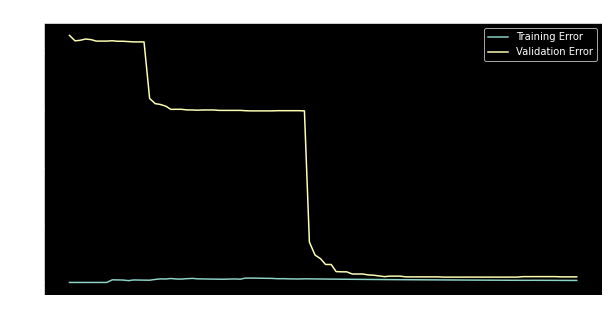

In [5]:
train_sizes=np.linspace(0.1, 1.0, 100)
learning_curves(clf, x_data_d, y_data_d, cv=5,N=train_sizes)

<h2><font color="LemonChiffon"> Hyperparameter Analysis </font></h2>

### Regularization & Overfitting

##### 1- Linear kernel

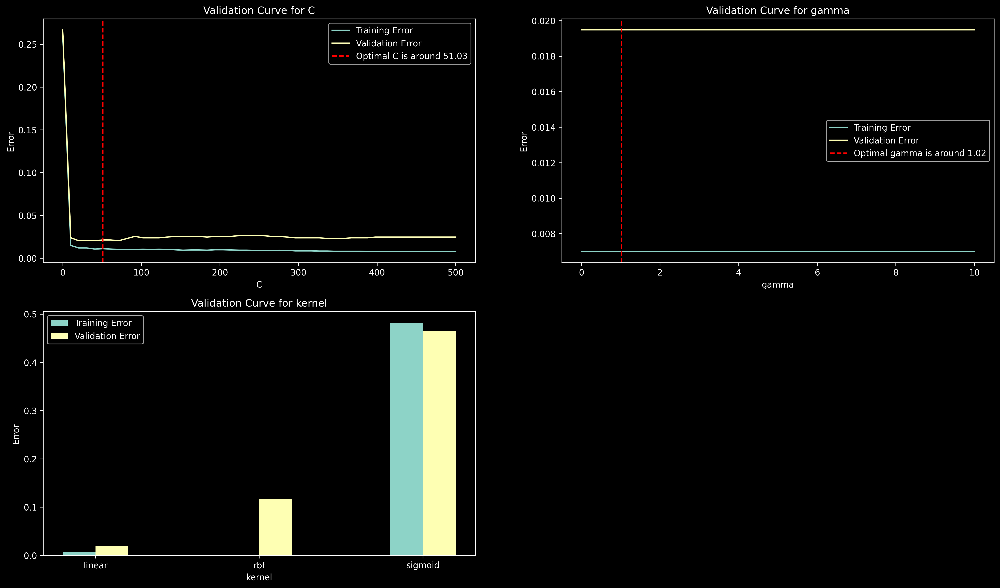

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Increasing value of C does not result in extreme overfitting.<br><br><font color="pink">✦</font> value of gamma has no effect since we use linear kernel.<br><br><font color="pink">✦</font> linear kernel is the best one for this data with least error. <br><br></font>

In [6]:
x_data_d, y_data_d = read_data(kind='Numerical')
clf.fit(x_data_d, y_data_d)
hyperparameters= {'C': np.linspace(0.01, 500),\
                  'gamma':  np.linspace(0.0001, 10),\
                  'kernel': ['linear' , 'rbf' ,'polynomial','sigmoid'] }

validation_curves(clf,x_data_d,y_data_d,5,hyperparameters)

convey_insights([
    "Increasing value of C does not result in extreme overfitting.",
    "value of gamma has no effect since we use linear kernel.",
    "linear kernel is the best one for this data with least error. ",
])

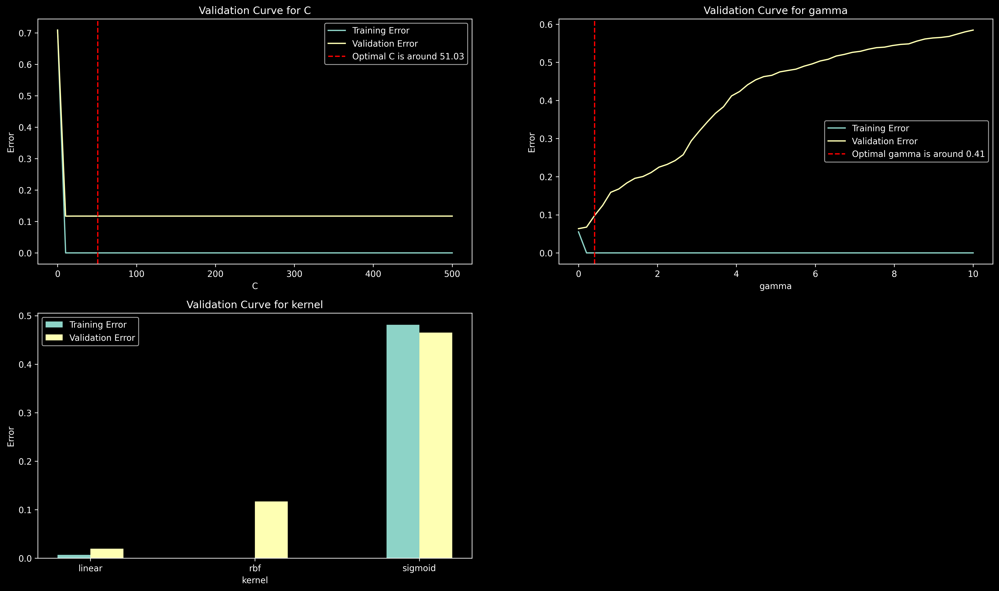

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Increasing value of C does not result in extreme overfitting.<br><br><font color="pink">✦</font> Increasing value of gamma does result in extreme overfitting.<br><br><font color="pink">✦</font> linear kernel is the best one for this data  <br><br></font>

In [7]:
x_data_d, y_data_d = read_data(kind='Numerical')
opt_params['kernel'] = 'rbf'
clf = svm.SVC(**opt_params)     
clf.fit(x_data_d, y_data_d)

hyperparameters= {'C': np.linspace(0.01, 500),\
                  'gamma':  np.linspace(0.0001, 10),\
                  'kernel': ['linear' , 'rbf' ,'polynomial','sigmoid'] }

validation_curves(clf,x_data_d,y_data_d,5,hyperparameters)

convey_insights([
    "Increasing value of C does not result in extreme overfitting.",
    "Increasing value of gamma does result in extreme overfitting.",
    "linear kernel is the best one for this data  ",
])

opt_params['kernel'] = 'linear'
clf = svm.SVC(**opt_params)

##### 2- rbf kernel

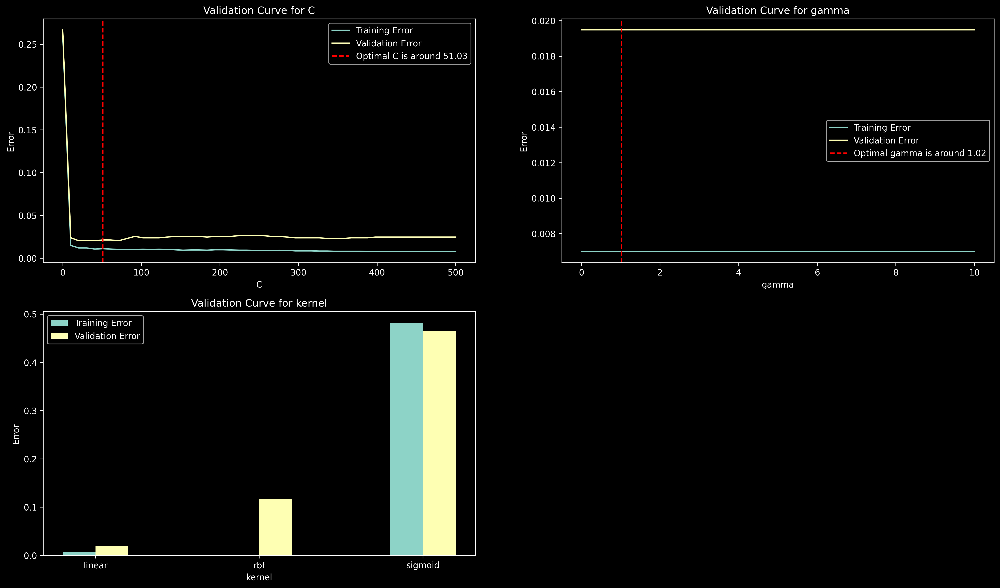

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Increasing value of C does not result in any overfitting.<br><br><font color="pink">✦</font> Increasing value of gamma does result in extreme overfitting.<br><br><font color="pink">✦</font> linear kernel is still the best one for this data  <br><br></font>

In [8]:
x_data_d, y_data_d = read_data(kind='Numerical')
clf.fit(x_data_d, y_data_d)

hyperparameters= {'C': np.linspace(0.01, 500),\
                  'gamma':  np.linspace(0.0001, 10),\
                  'kernel': ['linear' , 'rbf' ,'polynomial','sigmoid'] }

validation_curves(clf,x_data_d,y_data_d,5,hyperparameters)

convey_insights([
    "Increasing value of C does not result in any overfitting.",
    "Increasing value of gamma does result in extreme overfitting.",
    "linear kernel is still the best one for this data  ",
])

### Hyperparameter Search

#### 1- Support vectors' Number Scoring

In [9]:

opt_params = {}

hyperparameters= { 'C': loguniform(1e-5, 1e5),\
                  'gamma':  np.linspace(0.0001, 1),\
                  'kernel': ['linear' , 'rbf' ,'poly','sigmoid'] }

h_clf = svm.SVC()
random_search = RandomizedSearchCV(estimator=h_clf, param_distributions=hyperparameters, n_iter=100,\
                                scoring=svm_score, n_jobs=4, cv=5, random_state=42)
random_search.fit(x_data_d, y_data_d)

opt_params = random_search.best_params_
clear_output(wait=False)

opt_params['#support vectors'] = - random_search.best_score_
display(HTML(nice_table(opt_params, 'Optimal Configuration')))
opt_params.pop('#support vectors', None)

# save hyperparameters
save_hyperparameters(model_name, opt_params)

convey_insights([
    "May not strongly rely on this due validation set contamination",
    "If we do, we have held out another validation set to compare models"
])


C,gamma,kernel,#support vectors
1938.095,0.51025,linear,39.4


<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> May not strongly rely on this due validation set contamination<br><br><font color="pink">✦</font> If we do, we have held out another validation set to compare models<br><br></font>

#### 2- Accuracy scoring 


In [10]:
opt_params = {}

hyperparameters= { 'C': loguniform(1e-5, 1e5),\
    
                  'gamma':  np.linspace(0.0001, 1),\
                  'kernel': ['linear' , 'rbf' ,'poly','sigmoid'] }
# put range of c from 10^-5 to 10^5 in log space
      
h_clf = svm.SVC()
random_search = RandomizedSearchCV(estimator=h_clf, param_distributions=hyperparameters, n_iter=100,\
                                scoring='f1_weighted', n_jobs=4, cv=5, random_state=42)
random_search.fit(x_data_d, y_data_d)

opt_params = random_search.best_params_
clear_output(wait=False)

opt_params['WF1'] = random_search.best_score_
display(HTML(nice_table(opt_params, 'Optimal Configuration')))
opt_params.pop('WF1', None)

# save hyperparameters
save_hyperparameters(model_name, opt_params)

convey_insights([
    "May not strongly rely on this due validation set contamination",
    "If we do, we have held out another validation set to compare models"
])

C,gamma,kernel,WF1
1186.866,0.55107,linear,0.98052


<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> May not strongly rely on this due validation set contamination<br><br><font color="pink">✦</font> If we do, we have held out another validation set to compare models<br><br></font>

<h2><font color="LemonChiffon"> Features Analysis </font></h2>

### Feature Importance Analysis

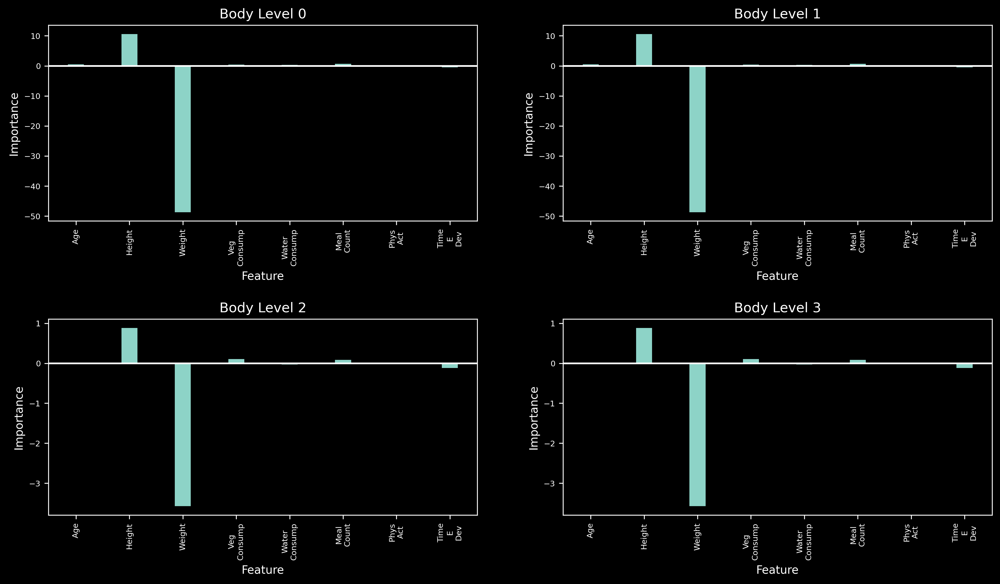

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Weight and height has the highest impact on the model.<br><br><font color="pink">✦</font> Veg Consumption, Meal Count and Time E Dev has less importance for the model.<br><br></font>

In [11]:
log_weights_analysis(clf, x_data_d)

convey_insights([
    "Weight and height has the highest impact on the model.",
    "Veg Consumption, Meal Count and Time E Dev has less importance for the model.",

])

### Recursive Feature Elimination 


Veg_Consump,Time_E_Dev,Phys_Act,Height,Weight
0.20372,0.20708,0.4861,7.344,24.121


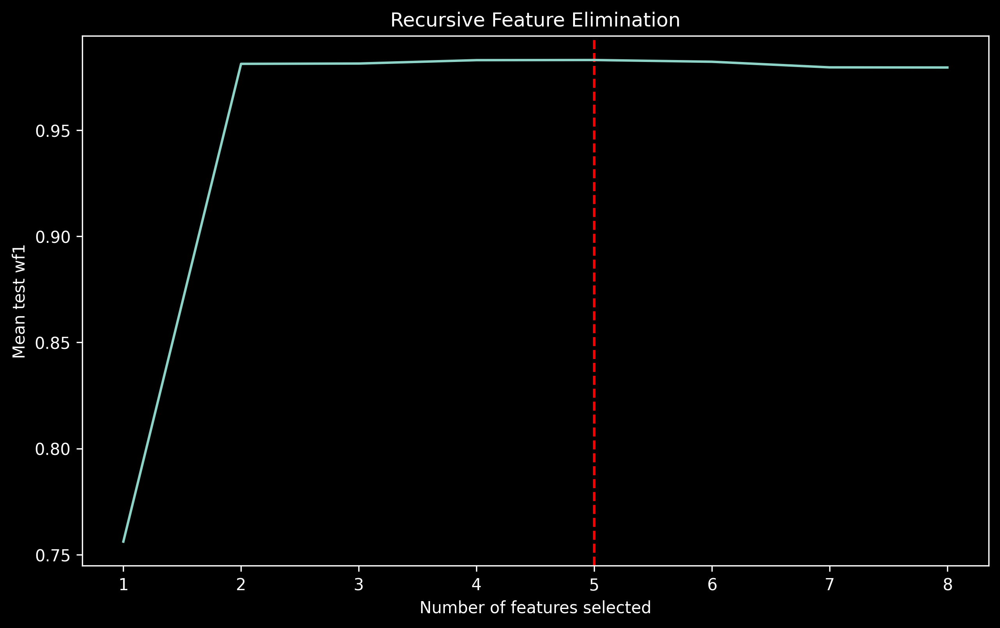

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Although Time_E_Dev has some importance, but elimination of it increase the accuracy.<br><br><font color="pink">✦</font> except for Time_E_Dev, Results do match expectations.<br><br></font>

In [12]:
x_data_r = recursive_feature_elimination(clf, 1, 10, x_data_d, y_data_d)
convey_insights([
    "Although Time_E_Dev has some importance, but elimination of it increase the accuracy.",
    "except for Time_E_Dev, Results do match expectations.",
])

<h2><font color="LemonChiffon"> Class Imbalance Analysis </font></h2>

### Testing Cost Sensitive & Sampling Methods

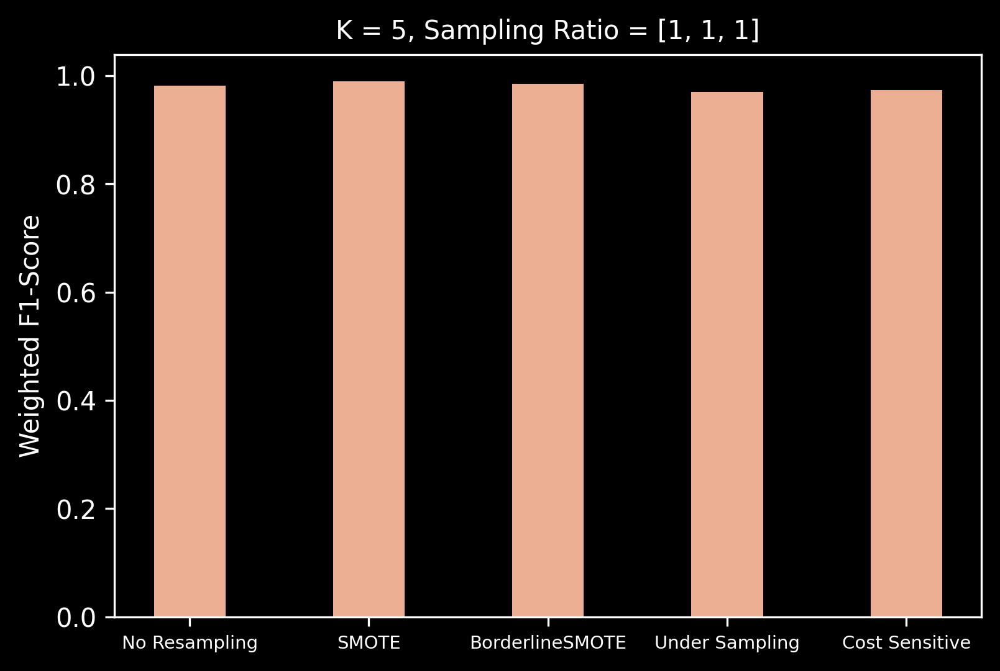

<Figure size 1800x1500 with 0 Axes>

In [13]:
### 1- evaluate All resampling methods and cost sensitive
methods=['No Resampling', 'SMOTE','BorderlineSMOTE','Under Sampling','Cost Sensitive']
sample_ratio=[1,1,1]
k=5
evaluate_class_imbalance_handler_over_methods(x_data_d,y_data_d ,clf , methods=methods , sample_ratio=[1,1,1], k=k)

### Evaluate Oversampling Methods for different K values and sampling ratios

<Figure size 1800x1200 with 0 Axes>

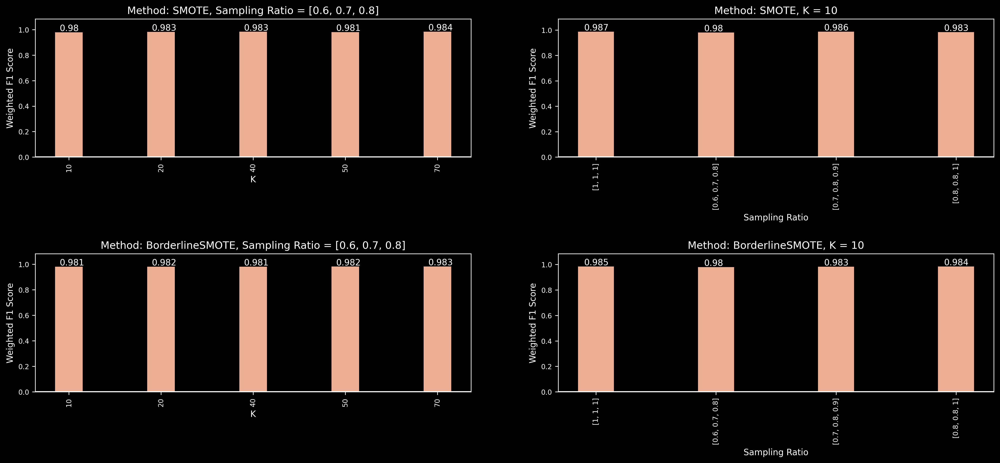

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Class imbalance seems to add no large benefit to the model<br><br></font>

In [14]:
methods = ['SMOTE', 'BorderlineSMOTE']
sample_ratios=[[1,1,1],[0.6,0.7,0.8],[0.7,0.8,0.9], [0.8,0.8,1] ]
const_k=10
const_sample_ratio=[0.6,0.7,0.8] 
Ks=[10,20,40,50,70]

plot_different_evaluations(x_data_d,y_data_d ,clf , methods=methods , sample_ratios=sample_ratios, Ks=Ks, const_k=const_k, const_sample_ratio=const_sample_ratio)


convey_insights([
    "Class imbalance seems to add no large benefit to the model",
])

<h2><font color="LemonChiffon"> Model Visualization </font></h2>

#### Final Model

100%|██████████| 90/90 [00:05<00:00, 15.16it/s]


(90, 800, 1200, 3) (90, 800, 1136, 4)


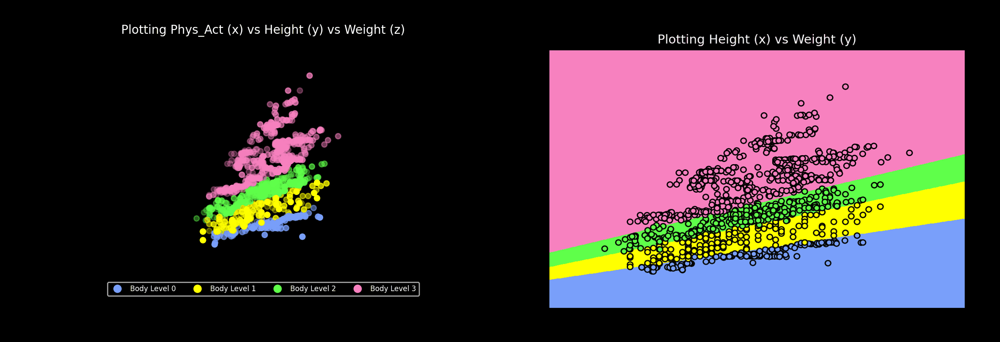

<h3><font color="pink" size=5>Insights</font></h3> <font size=4>
<font color="pink">✦</font> Isn't it beautiful?<br><br></font>

In [15]:
clf = svm.SVC(**opt_params)
clf.fit(x_data_r, y_data_d)
VisualizeModel('SVM', x_data_r, y_data_d, clf).double_whammy(animated=True)
convey_insights([
    "Isn't it beautiful?",
])